In [1]:
import torch

# Check if CUDA is available
cuda_available = torch.cuda.is_available()
print(f"CUDA available: {cuda_available}")


CUDA available: True


In [2]:
# Install the latest version of PyTorch with CUDA support
!pip install torch torchvision torchaudio


In [3]:
# Install pyyaml (latest version)
!pip install pyyaml


In [4]:
# Force a fresh installation of pyyaml without using cache
!pip install --no-cache-dir pyyaml


In [5]:
# Install precompiled binary wheel for pyyaml (avoid building from source)
!pip install --only-binary :all: pyyaml


In [6]:
# Install system dependencies required for PyYAML (in case it's missing)
!apt-get update
!apt-get install -y libyaml-dev


Get:1 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:8 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:10 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,108 kB]
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,477 kB]
Get:13 http://security.ubuntu.com/ubuntu jammy-sec

In [7]:
# Step 1: Upgrade pip (optional, but can help with compatibility)
!pip install --upgrade pip

# Step 2: Install PyYAML (latest version)
!pip install pyyaml

# Step 3: Install the latest version of torch and torchvision
!pip install torch torchvision torchaudio

# Step 4: Install Detectron2 from GitHub (this will install the latest compatible version)
!pip install git+https://github.com/facebookresearch/detectron2.git


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 28.1 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 24.1.2
    Uninstalling pip-24.1.2:
      Successfully uninstalled pip-24.1.2
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-_nihsgxi
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-_nihsgxi
  Resolved https://github.com/facebookresearch/detectron2.git to commit 9131ce0e5bc0c89904541bc0355d933ccd6acbfb
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 50.4 MB/s eta 0:00:00
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6355048 sha256=98990ffca95d91d34c377290bda205d240f92f1200d10858d27ae52ff3b14d64
  Stored in directory: /tmp/pip-ephem-wheel-cache-jv0mtwrm/wheels/47/e5

In [1]:
#Some basic setup:

#Setup detectron2 logger

import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

#import some common libraries

import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

#import some common detectron2 utilities

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [2]:
!curl -L "https://app.roboflow.com/ds/qraMNgtM2H?key=3ffbNHZYIV" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2371      0 --:--:-- --:--:-- --:--:--  2377
100 39.8M  100 39.8M    0     0  19.1M      0  0:00:02  0:00:02 --:--:-- 25.2M
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
   creating: test/
 extracting: test/0063_png_jpg.rf.f9a55355b0ad8029a0645cc989543224.jpg  
 extracting: test/0073_png_jpg.rf.1447b3c43dc351316a42b5bd68ed7cf5.jpg  
 extracting: test/0098_png_jpg.rf.29b5ac36f0090ff9001ca5c174f4ce55.jpg  
 extracting: test/0111_png_jpg.rf.59e2e0bca6d9fbb148e80c1d524c2fbb.jpg  
 extracting: test/25026311133_e0d3c6b62f_k_jpg.rf.e2612dd5de6626c791675ee7741a223a.jpg  
  inflating: test/_annotations.coco.json  
 extracting: test/aug_0066_png_jpg.rf.bd700ceac7661d37804958c8c66d2ffa.jpg  
 extracting: test/aug_0073_png_jpg.rf.b9052b577d92623a6576f50d24c

In [3]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [11/15 05:34:12 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/15 05:34:12 d2.data.datasets.coco]: Loaded 296 images in COCO format from /content/train/_annotations.coco.json


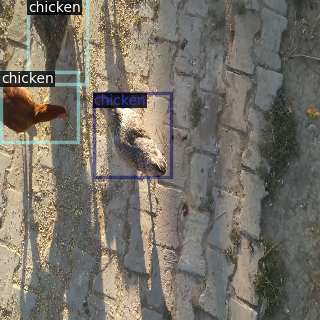

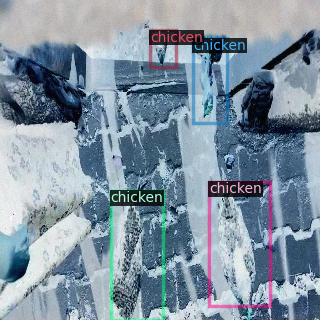

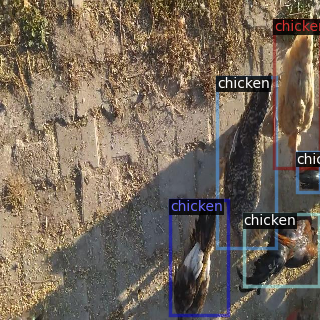

In [4]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])


In [5]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001  # pick a good LR
cfg.SOLVER.MAX_ITER = 5000   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6  # (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[11/15 05:34:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:01, 103MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[11/15 05:34:23 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[11/15 05:34:33 d2.utils.events]:  eta: 0:23:58  iter: 19  total_loss: 2.935  loss_cls: 2.028  loss_box_reg: 0.8428  loss_rpn_cls: 0.07652  loss_rpn_loc: 0.0252    time: 0.2916  last_time: 0.2905  data_time: 0.0153  last_data_time: 0.0048   lr: 1.9981e-05  max_mem: 1739M
[11/15 05:34:43 d2.utils.events]:  eta: 0:23:52  iter: 39  total_loss: 2.45  loss_cls: 1.57  loss_box_reg: 0.8458  loss_rpn_cls: 0.07285  loss_rpn_loc: 0.02124    time: 0.2934  last_time: 0.2852  data_time: 0.0085  last_data_time: 0.0047   lr: 3.9961e-05  max_mem: 1739M
[11/15 05:34:49 d2.utils.events]:  eta: 0:23:55  iter: 59  total_loss: 1.843  loss_cls: 0.9089  loss_box_reg: 0.8901  loss_rpn_cls: 0.03628  loss_rpn_loc: 0.02092    time: 0.2956  last_time: 0.2737  data_time: 0.0073  last_data_time: 0.0049   lr: 5.9941e-05  max_mem: 1739M
[11/15 05:34:55 d2.utils.events]:  eta: 0:23:39  iter: 79  total_loss: 1.5  loss_cls: 0.6009  loss_box_reg: 0.8396  loss_rpn_cls: 0.03437  loss_rpn_loc: 0.01891    time: 0.2909  last_

In [6]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# Set the test dataset in the configuration
cfg.DATASETS.TEST = ("my_dataset_test",)

# Create the evaluator using COCOEvaluator for the test dataset
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
# Build the test data loader
val_loader = build_detection_test_loader(cfg, "my_dataset_test")

# Evaluate the model using the trained weights
results = inference_on_dataset(trainer.model, val_loader, evaluator)

# Print the mAP and other metrics
print("Evaluation Results:", results)


WARNING [11/15 06:06:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [11/15 06:06:22 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/15 06:06:22 d2.data.datasets.coco]: Loaded 42 images in COCO format from /content/test/_annotations.coco.json
[11/15 06:06:22 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|  chicken   | 0            |  chicken   | 135          |
|            |              |            |              |
|   total    | 135          |            |              |
[11/15 06:06:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/15 06:06:22 d2.data.com

In [7]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator("my_dataset_train", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))


WARNING [11/15 06:06:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/15 06:06:37 d2.data.datasets.coco]: Loaded 42 images in COCO format from /content/test/_annotations.coco.json
[11/15 06:06:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/15 06:06:37 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[11/15 06:06:37 d2.data.common]: Serializing 42 elements to byte tensors and concatenating them all ...
[11/15 06:06:37 d2.data.common]: Serialized dataset takes 0.01 MiB
[11/15 06:06:37 d2.evaluation.evaluator]: Start inference on 42 batches
[11/15 06:06:38 d2.evaluation.evaluator]: Inference done 11/42. Dataloading: 0.0013 s/iter. Inference: 0.0800 s/iter. Eval: 0.0003 s/iter. Total: 0.0815 s/iter. ETA=0:00:02
[11/15 06:06:40 d2.evaluation.evalu

In [8]:
# Look at training curves in tensorboard:
%load_ext tensorboard

%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [9]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)

[11/15 06:07:11 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

In [10]:
test_metadata = MetadataCatalog.get("my_dataset_test")

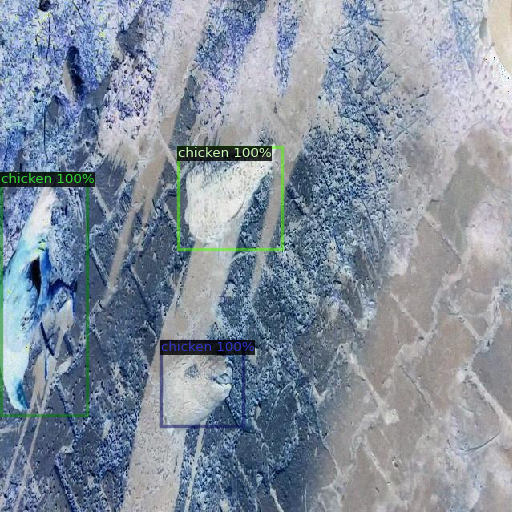

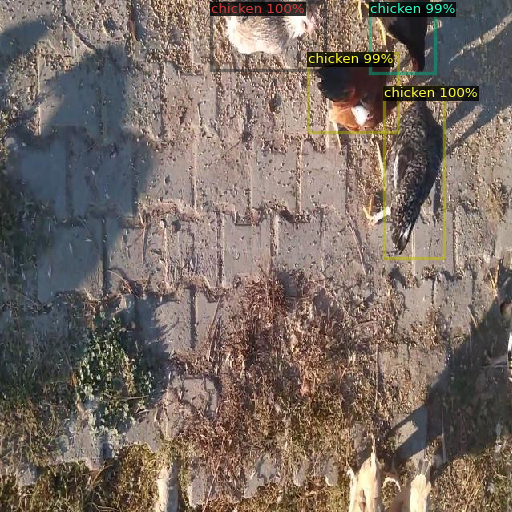

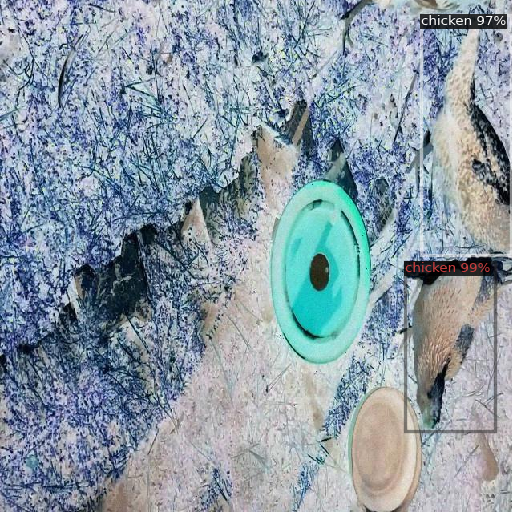

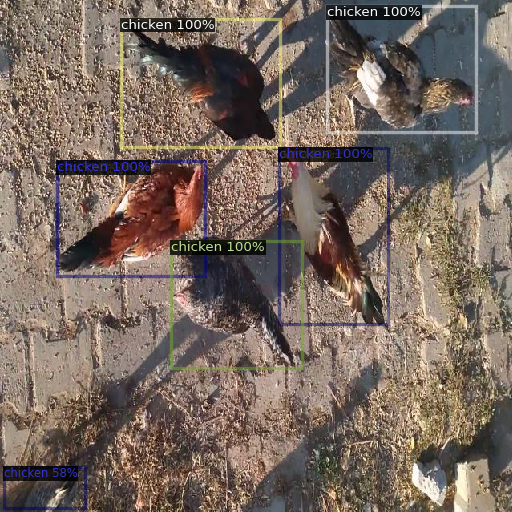

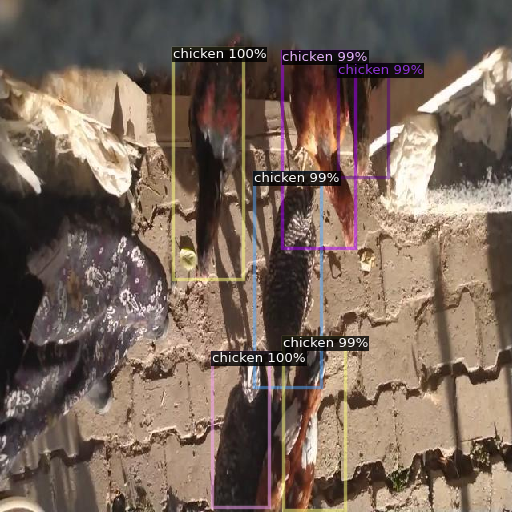

...

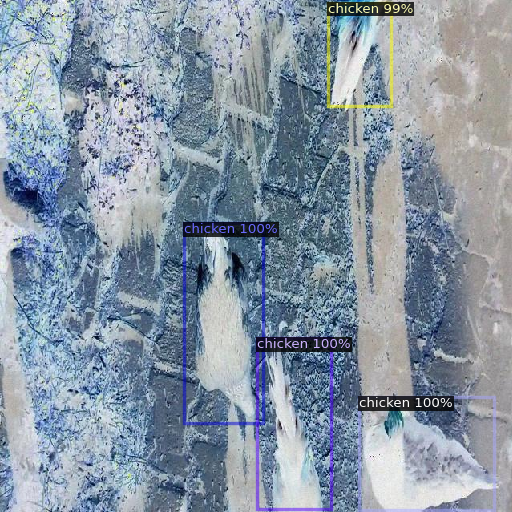

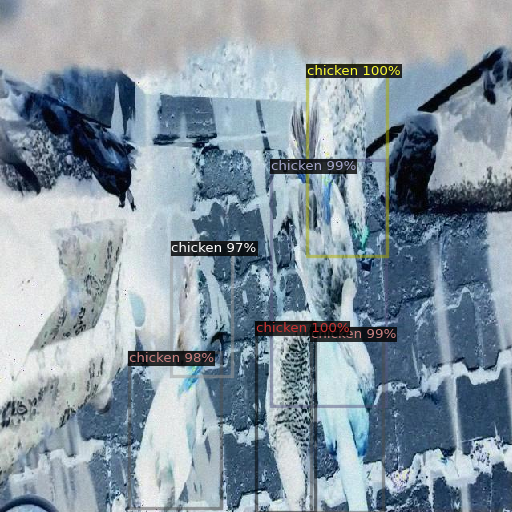

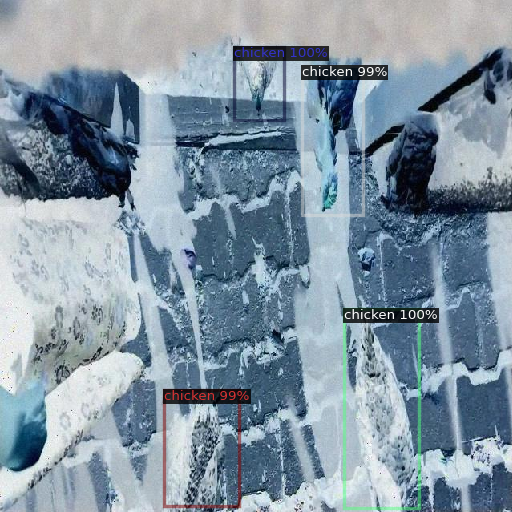

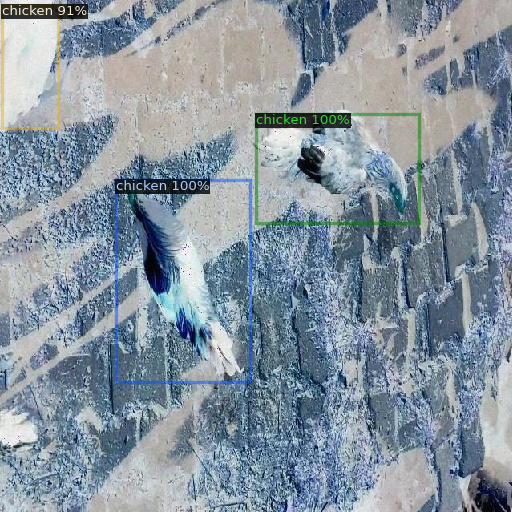

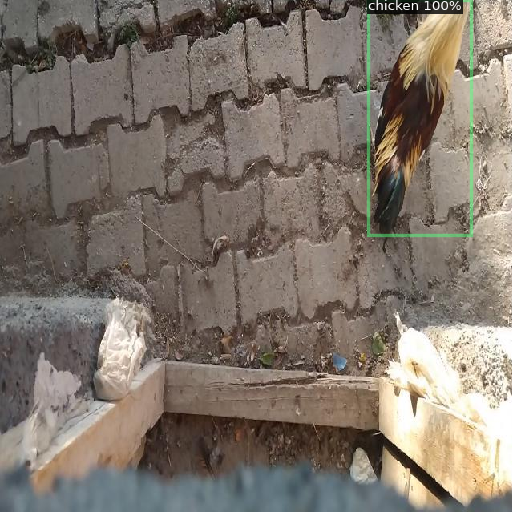

In [11]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)

[11/11 17:24:23 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

In [12]:
test_metadata = MetadataCatalog.get("my_dataset_test")

In [13]:
import os

# Get the size of the final model
model_path = './output/model_final.pth'
file_size_mb = os.path.getsize(model_path) / (1024 * 1024)  # Convert from bytes to MB
print(f"Model size: {file_size_mb:.2f} MB")

Model size: 314.93 MB


In [15]:
import psutil
import os

# Get the current memory usage after training
process = psutil.Process(os.getpid())
mem_info = process.memory_info()
print(f"Memory usage after training: {mem_info.rss / (1024 ** 3):.2f} GB")  # Converts to GB


Memory usage after training: 2.07 GB
